In [19]:
import numpy as np
from scipy import optimize as opt
from scipy.interpolate import UnivariateSpline as uni
import matplotlib.pyplot as plt
import convert

### Podatki DIN 8190 (8191)

In [20]:
# Oblika [ime, p, f, g1, g2]
podatki = [['06', 9.525, 3.76, 10.9, 6.7],
           ['08', 12.7, 5.085, 14.45, 8.7],
           ['12', 19.05, 7.44, 21, 10.7],
           ['16', 25.4, 10.04, 27.7, 14],
           ['24', 38.1, 14.95, 41, 21],
           ['32', 50.8, 19.93, 55, 28]]

### Člen

In [21]:
def preberi_datoteko(velikost):
    x = []
    y = []
    with open(f"..\\cleni\\{velikost}.IGS") as dat:
        a = dat.readlines()
        for line in a:
            if line[-9] == 'P' and line.count(',') == 4:
                line = line.split(',')
                if line[3] == '0.':
                    x.append(float(line[1]))
                    y.append(float(line[2]))

    # Da je zvezno dodaj prvo točko še na koncu
    x.append(x[0])
    y.append(y[0])
    return np.array(x), np.array(y)

In [22]:
class Clen():
    
    def __init__(self, podatki_i, barva):
        ime, self.p, self.f, self.g1, self.g2 = podatki_i
        self.barva = barva
        
        # Podatki
        self.alpha_k = 30
        self.alpha_r = np.deg2rad(self.alpha_k)
        
        (self.x, self.y) = preberi_datoteko(ime)
        self.tocka0 = [-self.p / 2, 0, self.p / 2, 0]
    
    def izris(self):
        "Izriše clen."
        plt.plot(self.x.flatten(), self.y.flatten(), self.barva)
        plt.plot(self.tocka0[0:3:2], self.tocka0[1:4:2], 'ro')
        plt.axis('equal')
        plt.grid()
        
    def rotacija(self, kot, clenek=0):  # kot v rad
        '''Naceloma je za clen ne potrebujem.'''
        for i, x_z, y_z in zip(range(len(self.x)), self.x, self.y):
                x_n = x_z * np.cos(kot) - y_z * np.sin(kot)  # novi x
                y_n = x_z * np.sin(kot) + y_z * np.cos(kot)  # novi y
                self.x[i] = x_n
                self.y[i] = y_n
        # tocka 0
        x0n1 = self.tocka0[0] * np.cos(kot) - self.tocka0[1] * np.sin(kot)
        y0n1 = self.tocka0[0] * np.sin(kot) + self.tocka0[1] * np.cos(kot)
        x0n2 = self.tocka0[2] * np.cos(kot) - self.tocka0[3] * np.sin(kot)
        y0n2 = self.tocka0[2] * np.sin(kot) + self.tocka0[3] * np.cos(kot)
        
        dx1 = self.tocka0[0] - x0n1
        dy1 = self.tocka0[1] - y0n1
        dx2 = self.tocka0[2] - x0n2
        dy2 = self.tocka0[3] - y0n2
        
        if clenek == 0:
            self.tocka0 = [x0n1, y0n1, x0n2, y0n2]
        
        elif clenek == 1:
            self.x += dx1
            self.y += dy1
            self.tocka0[2] = x0n2 + dx1
            self.tocka0[3] = y0n2 + dy1
        
        elif clenek == 2:
            self.x += dx2
            self.y += dy2
            self.tocka0[0] = x0n1 + dx2
            self.tocka0[1] = y0n1 + dy2
        
        else:
            raise Exception("Nepravilno izbran členek! Rotacija okrog\
                            izhodišča je 0, okrog levega členka je 1, okrog desnega je 2")
                
    def translacija_x(self, pomik):
        '''Za pomik premakne clen po x osi.'''
        self.x += pomik
        self.tocka0[0] += pomik
        self.tocka0[2] += pomik
        
    def translacija_y(self, pomik):
        '''Za pomik premakne clen po y osi.'''
        self.y += pomik
        self.tocka0[1] += pomik
        self.tocka0[3] += pomik

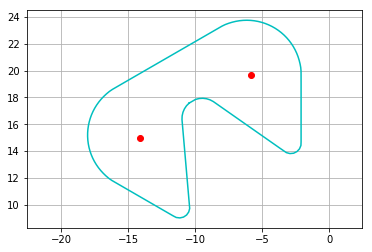

In [23]:
#Preizkus razreda clen:
c = Clen(podatki[0], 'c')
c.translacija_y(20)
c.rotacija(np.pi / 6, 0)
c.izris()

### Zob

In [24]:
class Zob():
    
    def __init__(self, podatki_i, z, x):
        
        '''Funkcija oblikuje zob verižnika za verigo s podatki podatki_i, s številom zob z, s profilnim pomikom x in na
        poziciji k.'''
        
        ime, p, f, g1, g2 = podatki_i
        modul = p / np.pi
        alpha_k = 30
        alpha_r = np.deg2rad(alpha_k)
        
        self.razdelni_premer = (z * p) / np.pi
        addendum = (1 + x) * modul
        dedendum = (1.25 - x) * modul 
        osnovni_premer = self.razdelni_premer - dedendum
        self.zunanji_premer = self.razdelni_premer + 2 * addendum
        self.krozni_korak = p / (self.razdelni_premer / 2)
        krozna_debelina_zoba = p / 2 + 2 * x * modul * np.tan(alpha_r)
        ksi_b = (p/2+ 2*(np.tan(alpha_r)-alpha_r)) / ((self.razdelni_premer / 2 + ((1.25-x)*modul))) # pred (...)*modul mora biti -

        u = 0
        r_trenutni = 0
        x_evo0 = [self.f_x_evolventa(osnovni_premer / 2, u)]
        y_evo0 = [self.f_y_evolventa(osnovni_premer / 2, u)]
        while r_trenutni < self.zunanji_premer / 2:
            napaka = 0.000002  # korak po katerem se pomika cez točke  0.000002
            u += napaka
            x_trenutni = self.f_x_evolventa(osnovni_premer / 2, u)
            y_trenutni = self.f_y_evolventa(osnovni_premer / 2, u)
            x_evo0.append(x_trenutni)
            y_evo0.append(y_trenutni)
            r_trenutni = np.sqrt(x_trenutni ** 2 + y_trenutni ** 2)
            if abs(r_trenutni - self.razdelni_premer / 2) <= ((self.razdelni_premer - osnovni_premer) / 2) / len(x_evo0):
                xy_razdelni = (x_trenutni, y_trenutni)

        zeljeno_stevilo_tock = 300  # število točk, ki jih uporabim na posameznem odseku. Če to želim zvečati,
                                    # moram zmanjšati korak! Drugače analiza: "Error: array without sequence."  500
        korak_po_tockah = int(len(x_evo0) / zeljeno_stevilo_tock) + 1
        x_evo1 = x_evo0[::korak_po_tockah]
        y_evo1 = y_evo0[::korak_po_tockah]

        x_evo1a, y_evo1a = np.array(x_evo1), np.array(y_evo1)
        
        y_evo1_z = -y_evo1a  # zrcalno
        x_evo2, y_evo2 = self.obrni(x_evo1a, y_evo1a, - ksi_b / 2)
        x_evo2_z, y_evo2_z = self.obrni(x_evo1a, y_evo1_z, ksi_b / 2)
        x_evo2_v = np.zeros(zeljeno_stevilo_tock) + x_evo2[-1]  # vmes
        y_evo2_v = np.linspace(y_evo2_z[-1], y_evo2[-1], zeljeno_stevilo_tock)
        
        self.x = []
        self.y = []
        self.x.append(self.obrni(x_evo2_z, y_evo2_z, np.pi / 2)[0])
        self.y.append(self.obrni(x_evo2_z, y_evo2_z, np.pi / 2)[1])
        self.x.append(self.obrni(x_evo2_v, y_evo2_v, np.pi / 2)[0])
        self.y.append(self.obrni(x_evo2_v, y_evo2_v, np.pi / 2)[1])
        self.x.append(self.obrni(x_evo2[::-1], y_evo2[::-1], np.pi / 2)[0])
        self.y.append(self.obrni(x_evo2[::-1], y_evo2[::-1], np.pi / 2)[1])
        
        self.x = np.array(self.x).flatten()
        self.y = np.array(self.y).flatten()
    
    def obrni(self, seznam_x, seznam_y, kot):  # kot v rad
        '''Ta funkcija nam služi le pri obračanju delov, ko sestavljamo zobnik. V nadaljevanju za vrtenje zobnika
        uporabljamo metodo rotacija.'''
        nov_seznam_x = []
        nov_seznam_y = []
        for x_z, y_z in zip(seznam_x, seznam_y):  # x_zacetni, y_zacetni
            x_n = x_z * np.cos(kot) - y_z * np.sin(kot)  # novi x
            y_n = x_z * np.sin(kot) + y_z * np.cos(kot)  # novi y
            nov_seznam_x.append(x_n)
            nov_seznam_y.append(y_n)
        return (np.array(nov_seznam_x), np.array(nov_seznam_y))

    def f_x_evolventa(self, a, u):
        return a * (np.cos(u) + u * np.sin(u))

    def f_y_evolventa(self, a, u):
        return a * (np.sin(u) - u * np.cos(u))
    
    def rotacija(self, kot):  # kot v rad
        '''Zavrti zob za kot "kot".'''
        for j, x_z, y_z in zip(range(len(self.x)), self.x, self.y):
            x_n = x_z * np.cos(kot) - y_z * np.sin(kot)  # novi x
            y_n = x_z * np.sin(kot) + y_z * np.cos(kot)  # novi y
            self.x[j] = x_n
            self.y[j] = y_n
    
    def izris(self):
        "Izriše zob."
        plt.plot(self.x, self.y, 'b')
        plt.axis('equal')
        plt.grid()


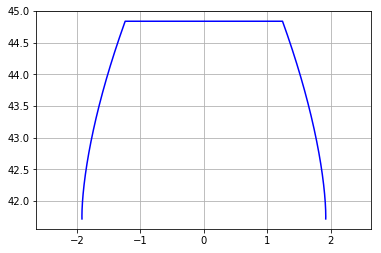

In [25]:

# Preizkus razreda verižnik:
v = Zob(podatki[0], 30, -1.2)
#v.rotacija(-np.pi/10)
v.izris()


### Analiza

In [31]:
class Analiza():
    
    def __init__(self, podatki_i, z, st_s, x, k):
        
        '''podatki_i podatki iz standarda DIN za zobnik in clen. z ... število zob, st_s ... število slik ko so
        členi spet na začetnem položaju. x ... profilni pomik. k kolikokrat členi pridejo mimo = kolikokrat se ponovi'''
        
        barve = ['C0', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9']
        globalni_stevec = 0
        
        ime, p = podatki_i[0:2]
        
        print("Vrsta: ", ime)
        print("Število zob: ", z)
        
        self.cleni = []
        self.zobje = []
        
        for i in reversed(range(-2, 6)):  # clen 0 na seznamu bo najbolj levi, clen 4 bo navpicen. Enako zobje.
            z_tr = Zob(podatki_i, z, x)
            z_tr.rotacija(i * z_tr.krozni_korak)
            
            self.zobje.append(z_tr)
        
        self.krozni_korak = self.zobje[0].krozni_korak
        
        self.c1 = Clen(podatki_i, barve[0])
        self.c1.translacija_y(self.zobje[0].razdelni_premer / 2)
        self.c2 = Clen(podatki_i, barve[1])
        self.c2.translacija_y(self.zobje[0].razdelni_premer / 2)        
        self.c2.translacija_x(p)
        self.c3 = Clen(podatki_i, barve[2])
        self.c3.translacija_y(self.zobje[0].razdelni_premer / 2)        
        self.c3.translacija_x(2 * p)
        
        for i in reversed(range(1,6)):
            c_tr = Clen(podatki_i, barve[i+2])
            c_tr.translacija_y(self.zobje[0].razdelni_premer / 2)
            c_tr.rotacija(i * self.krozni_korak)
            
            self.cleni.append(c_tr)
        
        
        st_kot = int(st_s / 8)
        
        self.kot_analize = 1.01 * (self.krozni_korak / st_kot)  # Da bo na koncu 1% čez ( se ne bo opazilo zamika)
        
        self.ime = 0
        self.izris()
        self.ime += 1
    
        self.kot_tr = 0
        stevec = 0        
        analiza = True
        while analiza == True:
            stevec += 1
            if stevec %1 == 0:  # izriše le vsako 10 - to
                self.izris()
                self.ime += 1
            
            if abs(self.kot_tr - self.kot_analize) >= self.krozni_korak:
                globalni_stevec += 1
                if globalni_stevec == k * 8:
                    analiza = False
                
                kot_vrtenja = self.krozni_korak + self.kot_tr  #self.kot_tr je negativen
                
                self.korak(-kot_vrtenja)
                #self.izris()
                self.kot_tr = 0
                stevec = 0
                
                # Premecemo clene
                self.c3.translacija_x(-3 * p)
                self.c3.rotacija(5 * self.krozni_korak)
                self.cleni[0:0] = [self.c3]
                self.c3 = self.c2
                self.c2 = self.c1
                self.c1 = self.cleni.pop(-1)
                
                # Premecemo zobe
                self.zobje[-1].rotacija(8 * self.krozni_korak)
                self.zobje[0:0] = [self.zobje.pop(-1)]
            
            else:
                self.korak(-self.kot_analize)
                
                
    def korak(self, kot):
        
        self.kot_tr += kot
        
        for z_tr in self.zobje:
            z_tr.rotacija(kot)
        for c_tr in self.cleni:
            c_tr.rotacija(kot)
        
        dx = c_tr.tocka0[2] - self.c1.tocka0[0]
        dy = c_tr.tocka0[3] - self.c1.tocka0[1]
        self.c1.translacija_x(dx)
        self.c2.translacija_x(dx)
        self.c3.translacija_x(dx)
        self.c1.translacija_y(dy)
        self.c2.translacija_y(dy)
        self.c3.translacija_y(dy)
        
                               
    def izris(self):
        '''Izriše člen in verižnik.'''

        self.c1.izris()
        self.c2.izris()
        self.c3.izris()
        for a in self.cleni:
            a.izris()
        for a in self.zobje:
            a.izris()
        plt.xlim(-35, 20)
        plt.ylim(20, 55)
        plt.savefig(f'..\\slike\\{str(self.ime)}.png')
        plt.show()


Vrsta:  06
Število zob:  30


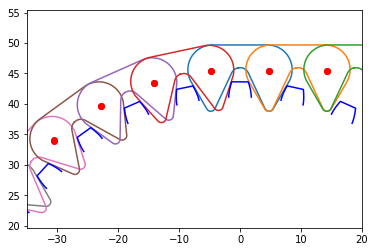

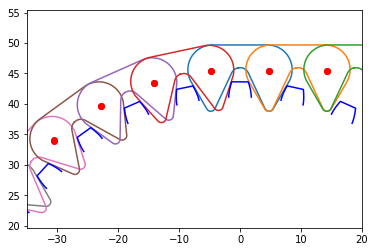

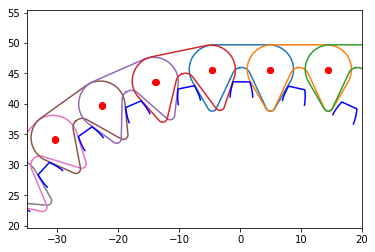

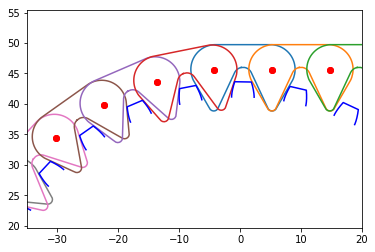

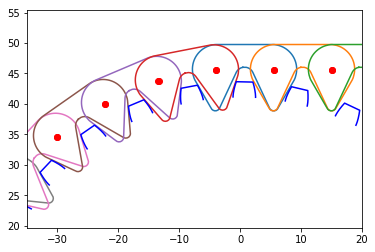

...

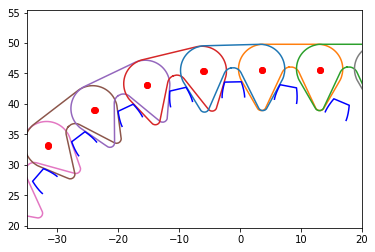

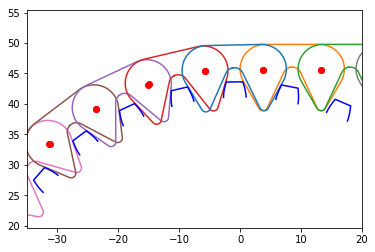

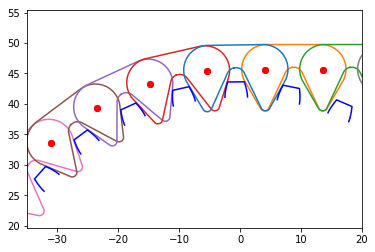

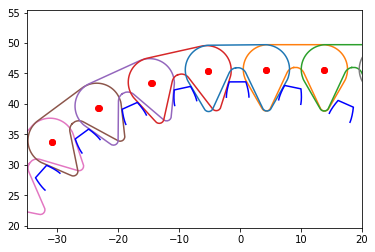

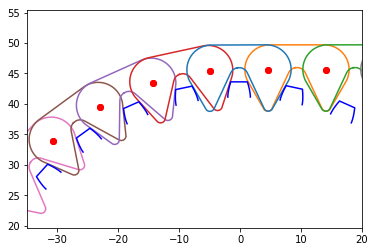

In [32]:
Analiza(podatki_i = podatki[0], z = 30, st_s= 300, x = -1.6, k=3);

Čisto vredu st_s = 300, 15 frame

Nato slike v imageJ:

-import -> image sequence

-save as AVI (15 frame)